# **YOLO (you only look once)**

In [ ]:
# its a real time object detection algorithm in computer vision.
# its a SOTA(state of the art) MODEL.
# its a Neural Network Approach.
# it is trained with Coconut dataset.

In [1]:
# COCO(common object in context) is a large-scale object detection, segmentation, and captioning dataset.

    #### COCO has several features :-

# Object segmentation
# Recognition in context
# Superpixel stuff segmentation
# 330K images (>200K labeled)
# 1.5 million object instances
# 80 object categories
# 91 stuff categories
# 5 captions per image
# 250,000 people with keypoints


In [ ]:
import numpy as np
import pandas as pd
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
import matplotlib.pyplot as plt

In [ ]:
!wget "https://raw.githubusercontent.com/abidrahmank/OpenCV2-Python-Tutorials/master/data/messi5.jpg" -O messi5.jpg q

--2024-08-13 03:20:04--  https://raw.githubusercontent.com/abidrahmank/OpenCV2-Python-Tutorials/master/data/messi5.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 72937 (71K) [image/jpeg]
Saving to: ‘messi5.jpg’

messi5.jpg          100%[===================>]  71.23K  --.-KB/s    in 0.002s  

2024-08-13 03:20:04 (42.1 MB/s) - ‘messi5.jpg’ saved [72937/72937]

--2024-08-13 03:20:04--  http://q/
Resolving q (q)... failed: Name or service not known.
wget: unable to resolve host address ‘q’
FINISHED --2024-08-13 03:20:04--
Total wall clock time: 0.3s
Downloaded: 1 files, 71K in 0.002s (42.1 MB/s)


In [ ]:
!ls -l

total 76
-rw-r--r-- 1 root root 72937 Aug 13 03:20 messi5.jpg
drwxr-xr-x 1 root root  4096 Aug  9 13:22 sample_data


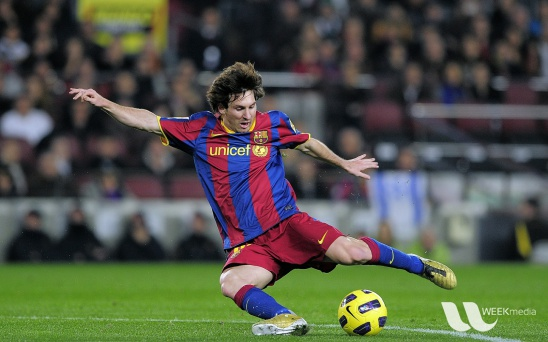

In [ ]:
img1 = cv2.imread('messi5.jpg')

cv2_imshow(img1)

In [ ]:
img1.shape

(342, 548, 3)

In [ ]:
print(img1[100,100])

[157 166 200]


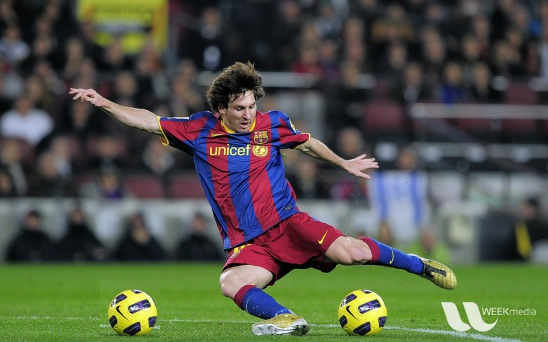

In [ ]:
ball = img1[280:340, 330:390]
img1[280:340, 100:160] = ball
cv2_imshow(img1)
# football is placed in other place in this image

In [ ]:
! wget https://upload.wikimedia.org/wikipedia/commons/thumb/5/53/OpenCV_Logo_with_text.png/487px-OpenCV_Logo_with_text.png -O opencv_logo.png

--2024-08-13 03:33:32--  https://upload.wikimedia.org/wikipedia/commons/thumb/5/53/OpenCV_Logo_with_text.png/487px-OpenCV_Logo_with_text.png
Resolving upload.wikimedia.org (upload.wikimedia.org)... 103.102.166.240, 2001:df2:e500:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|103.102.166.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 30128 (29K) [image/png]
Saving to: ‘opencv_logo.png’

opencv_logo.png     100%[===================>]  29.42K  --.-KB/s    in 0.001s  

2024-08-13 03:33:32 (24.6 MB/s) - ‘opencv_logo.png’ saved [30128/30128]



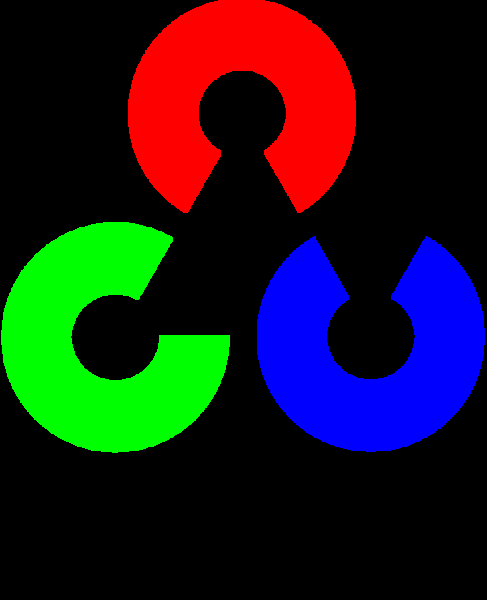

In [ ]:
img2 = cv2.imread('opencv_logo.png')

cv2_imshow(img2)

In [ ]:
img2.shape

(600, 487, 3)

In [ ]:
img1.shape

(342, 548, 3)

In [ ]:
img2_resized = cv2.resize(img2, (img1.shape[1], img1.shape[0]))

In [ ]:
img2_resized.shape

(342, 548, 3)

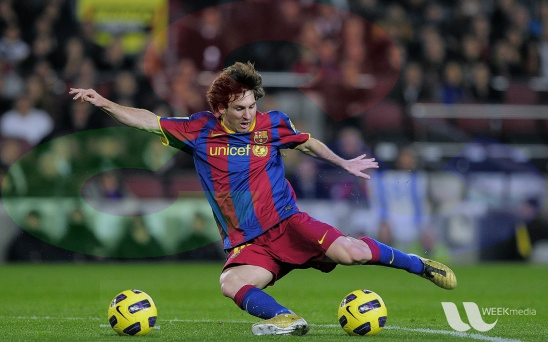

In [ ]:
dst = cv2.addWeighted(img1, 0.9, img2_resized, 0.1,0)
# img1 visibility is 90% and img2 visibility is 10% and thickness is 0S
cv2_imshow(dst)

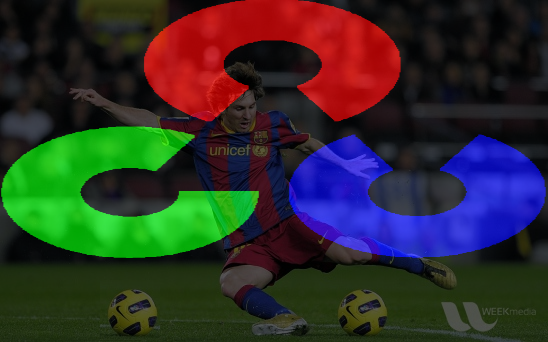

In [ ]:
dst = cv2.addWeighted(img1, 0.35, img2_resized, 0.65,0)
# img1 visibility is 40% and img2 visibility is 30% and thickness is 0
cv2_imshow(dst)

# YOLO NAS - SOTA model (state of the art model)

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
%cd /content/gdrive/MyDrive

/content/gdrive/MyDrive


In [ ]:
import os
if not os.path.isdir("morningbatch"):
  os.makedirs('morningbatch')

In [ ]:
%cd morningbatch

/content/gdrive/MyDrive/morningbatch


# YOLO Algorithm

In [ ]:
!pip install super-gradients

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.7/41.7 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 684.5/684.5 kB 32.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of albumentations to determine which version is compatible with other requirements. This could take a while.
INFO: pip is still looking at multiple versions of albumentations to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.3/108.3 kB 13.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 913.9/913.9 kB 49.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ..

In [ ]:
import super_gradients

[2024-08-13 04:06:35] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /root/sg_logs/console.log


[2024-08-13 04:06:43] INFO - utils.py - NumExpr defaulting to 2 threads.


In [ ]:
# COCO Data : 33 millions of data
yolo_model = super_gradients.training.models.get('yolo_nas_l', pretrained_weights='coco')
yolo_model

[2024-08-13 04:10:07] WARNING - checkpoint_utils.py - :warning: The pre-trained models provided by SuperGradients may have their own licenses or terms and conditions derived from the dataset used for pre-training.
 It is your responsibility to determine whether you have permission to use the models for your use case.
 The model you have requested was pre-trained on the coco dataset, published under the following terms: https://cocodataset.org/#termsofuse
[2024-08-13 04:10:07] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_l_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_l_coco.pth
100%|██████████| 256M/256M [00:17<00:00, 15.7MB/s]
[2024-08-13 04:10:26] INFO - checkpoin

YoloNAS_L(
  (backbone): NStageBackbone(
    (stem): YoloNASStem(
      (conv): QARepVGGBlock(
        (nonlinearity): ReLU(inplace=True)
        (se): Identity()
        (branch_3x3): Sequential(
          (conv): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        )
        (branch_1x1): Conv2d(3, 48, kernel_size=(1, 1), stride=(2, 2))
        (post_bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (rbr_reparam): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      )
    )
    (stage1): YoloNASStage(
      (downsample): QARepVGGBlock(
        (nonlinearity): ReLU(inplace=True)
        (se): Identity()
        (branch_3x3): Sequential(
          (conv): Conv2d(48, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=Tr

[2024-08-13 04:12:49] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


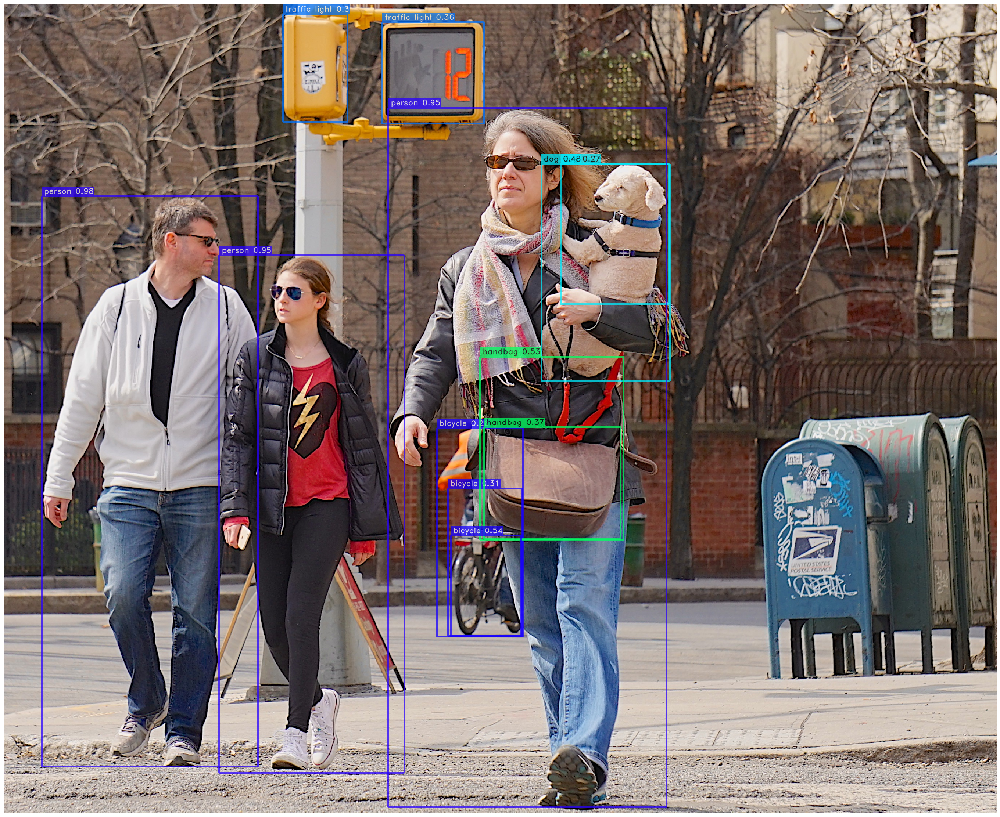

In [ ]:
url = "/content/17214488690_d81a0ee584_o.jpg"
yolo_model.predict(url, conf=0.25).show()
# here directly i got labelling,accuracy and boundary box

[2024-08-13 04:15:06] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


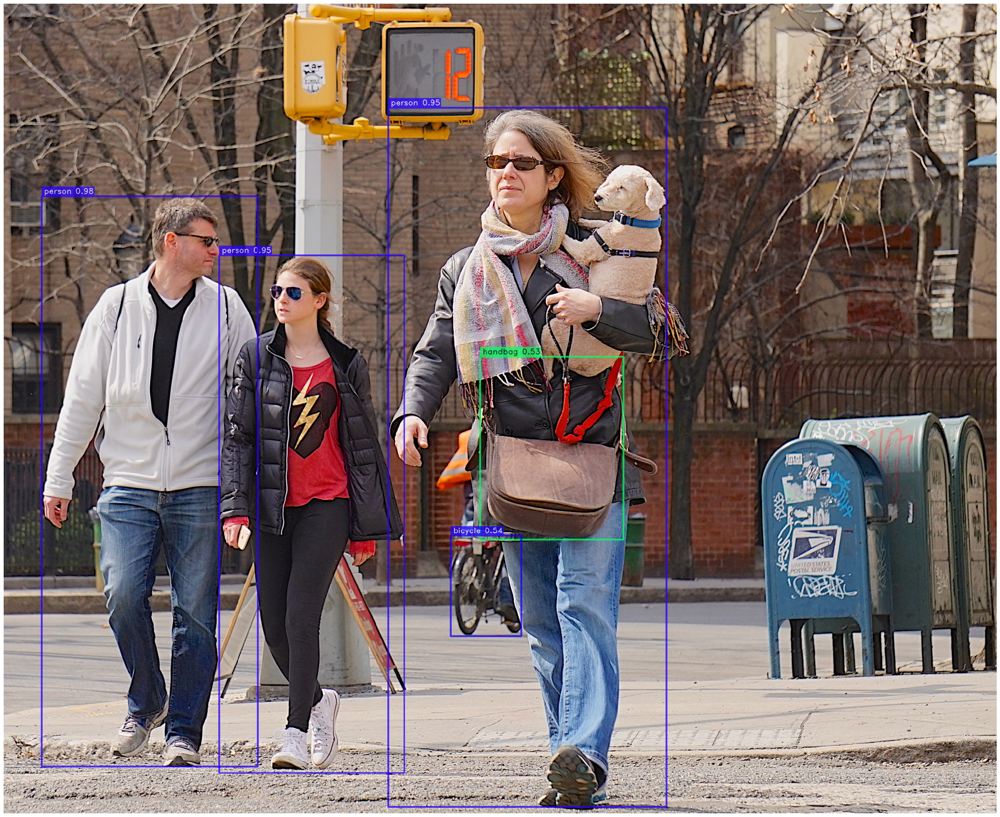

In [ ]:
url = "/content/17214488690_d81a0ee584_o.jpg"
yolo_model.predict(url, conf=0.50).show()
# here i can increase the conf(confidence/probability) value, in video most of the time i will use more then 50% accuracy.
# here if i will use more then 50% then wwhich is coming less then 50% that object would be ignore.

[2024-08-13 04:16:45] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


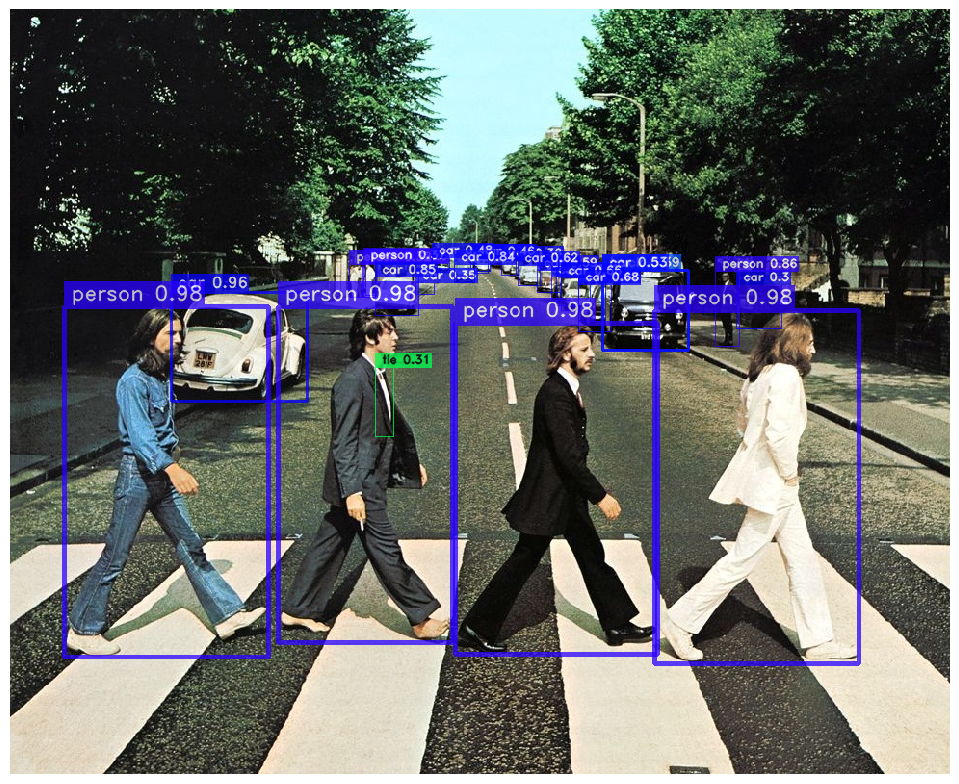

In [ ]:
url = "/content/beatles-abbeyroad.jpg"
yolo_model.predict(url, conf=0.25).show()

[2024-08-13 04:18:16] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


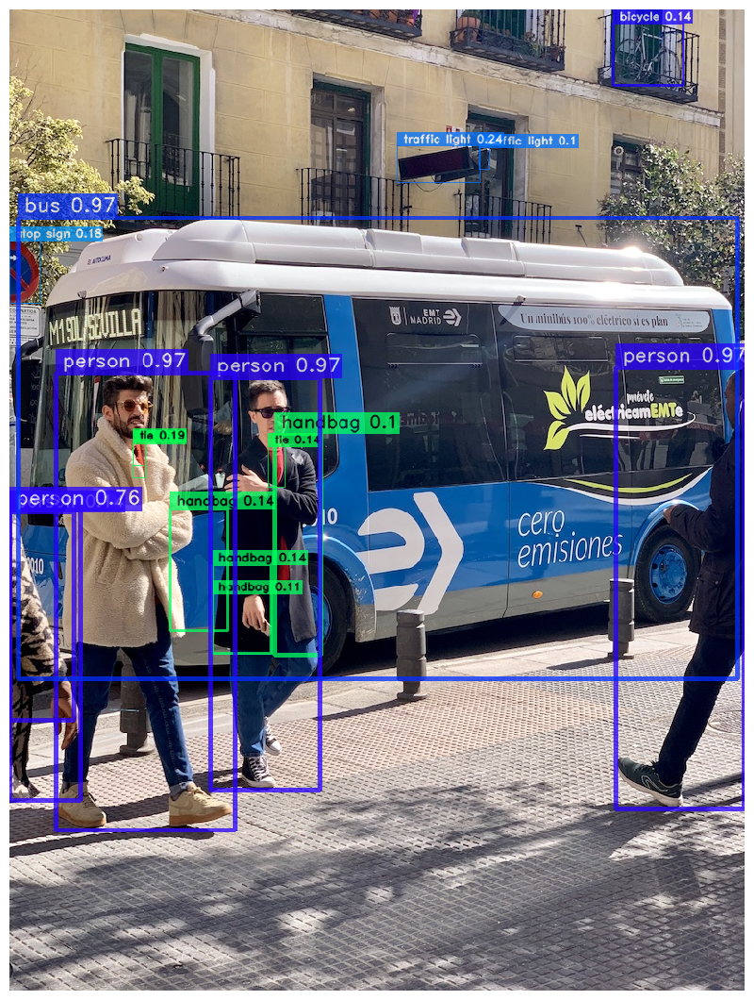

In [ ]:
url = "/content/bus.jpg"
yolo_model.predict(url, conf=0.10).show()

[2024-08-13 04:20:12] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


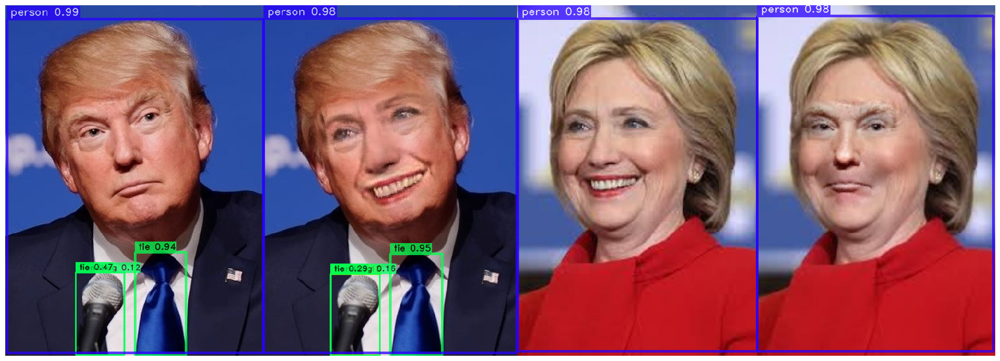

In [ ]:
url = "/content/faceswap.JPG"
yolo_model.predict(url, conf=0.10).show()

In [ ]:
import torch
#device = 'cuda' if torch.cuda.is_avaiable() else 'cpu'

AttributeError: module 'torch.cuda' has no attribute 'is_avaiable'